In [1]:
import os
import pandas as pd
import numpy as np

In [3]:
%%capture
!pip install openpyxl
!pip install seaborn
!pip install notebookjs
!pip install pydub
# !pip install -U kaleido

In [2]:
df_annotations = pd.read_excel(f'{os.path.abspath("..")}/data/annotations.xlsx')

In [3]:
PC_Num, Part_Num = 1540, 1
EMO_Valence = 'Valence'
EMO_Arousal = 'Arousal'
EMO_Dominance = 'Dominance'

In [4]:
dfannotation_vale = df_annotations[df_annotations['Emotion'] == EMO_Valence]
dfannotation_vale.sample(5)

,Name,Emotion,Annotator,PC_Num,Part_Num
2431,MSP-Conversation_0912_3_017.csv,Valence,17,912,3
3510,MSP-Conversation_1669_4_007.csv,Valence,7,1669,4
1510,MSP-Conversation_0584_3_019.csv,Valence,19,584,3
3879,MSP-Conversation_2100_1_013.csv,Valence,13,2100,1
144,MSP-Conversation_0054_2_019.csv,Valence,19,54,2


In [5]:
def mean_vote(df_annotations: pd.DataFrame, PC_Num:int, Part_Num:int, emotion:str) -> pd.DataFrame:
    
    all_annot = [] 
    time = pd.DataFrame(columns = ['Time','Annotation','Annotator'])
    
    df_copy = df_annotations[(df_annotations.PC_Num == PC_Num) & (df_annotations.Part_Num == Part_Num) & (df_annotations.Emotion == emotion)]
    
    # Leo cada audio, para cada anotador para le emoción especificada{}
    for name, annotator, emot in zip(df_copy['Name'], df_copy['Annotator'], df_copy['Emotion']):
    
        temp_df = pd.read_csv(f'{os.path.abspath("..")}/data/MSPCORPUS/Annotations/{emot}/{name}', skiprows=9, header=None, names=['Time', 'Annotation'])
        temp_df['Annotator'] = annotator
        time = pd.concat([time, temp_df], ignore_index = True)
        
        all_annot.append(temp_df)
        
    df_pivot = pd.DataFrame(time.pivot_table(columns = 'Annotator', index = 'Time', values = 'Annotation').to_records()).set_index('Time')
    df_pivot = df_pivot.fillna(method='ffill')
    df_pivot['Votación'] = df_pivot.mean(axis = 1)
    
    return df_pivot

In [6]:
df = mean_vote(df_annotations, PC_Num, Part_Num, EMO_Valence)
# df_arou = mean_vote(df_annotations, PC_Num, Part_Num, EMO_Arousal)
# df_domi = mean_vote(df_annotations, PC_Num, Part_Num, EMO_Dominance)df

df

,7,10,13,14,17,19,Votación
Time,,,,,,,
0.040000,0.00,-0.01,0.00,0.00,-0.01,0.00,-0.003333
0.056944,0.00,-0.01,0.00,0.00,-0.01,0.00,-0.003333
0.060974,0.00,-0.01,0.00,0.00,-0.01,0.00,-0.003333
0.072634,0.00,-0.01,0.00,0.00,-0.01,0.00,-0.003333
0.073124,0.00,-0.01,0.00,0.00,-0.01,0.00,-0.003333
...,...,...,...,...,...,...,...
268.512200,4.88,4.72,38.28,33.59,56.69,2.34,23.416667
268.515100,4.88,4.72,38.28,33.59,56.69,2.34,23.416667
268.528700,4.88,4.72,38.28,33.59,56.69,2.34,23.416667


In [8]:
raters = df.T[0:-1].to_numpy() * 100 
raters = raters.astype(np.int16) 
raters

array([[   0,    0,    0, ...,  488,  488,  488],
       [  -1,   -1,   -1, ...,  472,  472,  472],
       [   0,    0,    0, ..., 3828, 3828, 3828],
       [   0,    0,    0, ..., 3359, 3359, 3359],
       [  -1,   -1,   -1, ..., 5669, 5669, 5669],
       [   0,    0,    0, ...,  234,  234,  234]], dtype=int16)

In [9]:
annot_list = 'annot-' + df.columns.values[0:-1]
annot_list

array(['annot-7', 'annot-10', 'annot-13', 'annot-14', 'annot-17',
       'annot-19'], dtype=object)

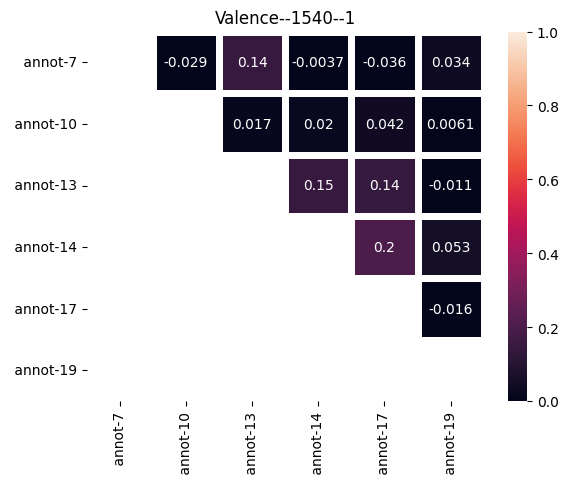

In [10]:
import itertools

from sklearn.metrics import cohen_kappa_score
import numpy as np


data = np.zeros((len(raters), len(raters)))
# robado de stackaverflow
# Calculate cohen_kappa_score for every combination of raters
# Combinations are only calculated j -> k, but not k -> j, which are equal
# So not all places in the matrix are filled.
for j, k in list(itertools.combinations(range(len(raters)), r=2)):
    data[j, k] = cohen_kappa_score(raters[j], raters[k], weights='linear')
# fin del robo

import seaborn as sns
import matplotlib.pyplot as plt

ax = plt.axes()
ax.set_title(f'{EMO_Valence}--{PC_Num}--{Part_Num}')

sns.heatmap(
    data, 
    mask=np.tri(len(raters)),
    annot=True, linewidths=5,
    vmin=0, vmax=1,
    xticklabels=[f" {a}" for a in annot_list],
    yticklabels=[f" {a}" for a in annot_list],
)
plt.show()


In [11]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

reps = []
print("*** Anotador c/u cohen_kappa_score + la suma horizontal ")
for idx, a in enumerate(annot_list):
    rep = data[:, idx] + data[idx, :]
    reps.append(np.sum(rep))
    print(a, np.round(rep, 4), np.sum(rep),)

reps = np.array(reps)
print("-"*100)
scaler = MinMaxScaler()
annot_list = np.array(annot_list).reshape(-1, 1)
#################
# Objetivo: suma del cohen_kappa_score de cada anotador como peso para sacar el "weighted average"
# Razon por la que se usa MinMaxScaler [0, 1] 
#################
reps_scaled = scaler.fit_transform(reps.reshape(-1, 1))
out = np.hstack((annot_list, reps_scaled))
out = {u[0]:u[1] for u in out}
print("*** Anotador con la suma de sus scores transformada a [0,1] MinMaxScaler \n*** Objetivo: usar np.average con estos pesos.")
out

*** Anotador c/u cohen_kappa_score + la suma horizontal 
annot-7 [ 0.     -0.0294  0.1446 -0.0037 -0.0362  0.0339] 0.10914089733051002
annot-10 [-0.0294  0.      0.0167  0.0203  0.042   0.0061] 0.055611322279278896
annot-13 [ 0.1446  0.0167  0.      0.1452  0.1406 -0.0109] 0.4362445622212815
annot-14 [-0.0037  0.0203  0.1452  0.      0.2018  0.0532] 0.41679901131928077
annot-17 [-0.0362  0.042   0.1406  0.2018  0.     -0.016 ] 0.33218891544724616
annot-19 [ 0.0339  0.0061 -0.0109  0.0532 -0.016   0.    ] 0.06613380986849515
----------------------------------------------------------------------------------------------------
*** Anotador con la suma de sus scores transformada a [0,1] MinMaxScaler 
*** Objetivo: usar np.average con estos pesos.


{'annot-7': 0.1406329490808198,
 'annot-10': 0.0,
 'annot-13': 1.0,
 'annot-14': 0.9489126306862647,
 'annot-17': 0.7266249085605598,
 'annot-19': 0.027644689125993244}

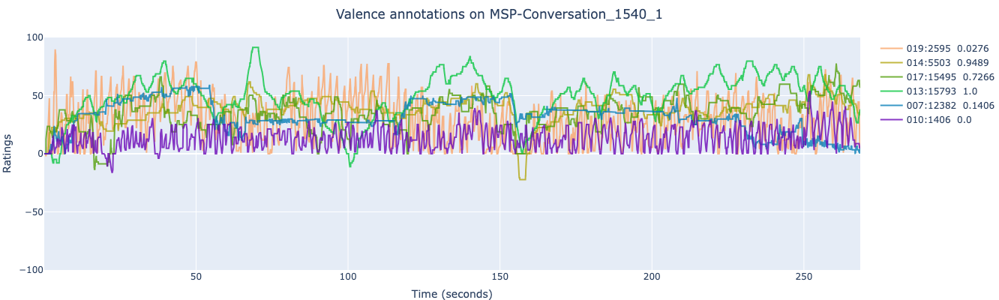

In [12]:
from pathlib import Path
from operator import itemgetter 


import plotly.express as px
import plotly.graph_objects as go

root_path = "/Users/beltre.wilton/Downloads/SER-Datasets/MSP-Conversation-1.1"

def get_dfannot_by_dim(emot: str):
    """Get df of MSP-Conversation files part"""
    ANNOTATIONS_PATH = Path(f'{root_path}/Annotations/{emot}')
    
    anns = []
    # Itero por todos los csv de la carpeta emot
    for ann in ANNOTATIONS_PATH.rglob("*.csv"):
        # Se abre cada archivo csv
        with open(ann.__str__(), 'rbU') as af:
            # Se define la variable linea como la cantidad de lineas del archivo exceptuando las 9 iniciales que son cabeceras
            lines = sum(1 for _ in af) - 9
        anns.append([ann.name[17:21], ann.name[22:23], ann.name[24:27], ann.name, lines])
    
    dfannotation = pd.DataFrame(data=anns, columns=['PC_Num', 'Part_Num', 'Annotator', 'Name', 'Lines'])
    dfannotation[['PC_Num', 'Part_Num', 'Lines']] =  dfannotation[['PC_Num', 'Part_Num', 'Lines']].astype(int)
    dfannotation = dfannotation.sort_values(by=['PC_Num', 'Part_Num'])
    dfannotation = dfannotation.reset_index(drop=True)
    
    return dfannotation

def filter_dfannotation(emot: str, dfannotation:  pd.DataFrame, pc_num: int, part_num: int) -> list:
    """ Filter by lookup a pc_num (podcast number) with par_num (each piece of file) """
    all_annot = [] 
    # Leo cada audio, para cada anotador para le emoción especificada
    for name, annotator, lines in zip(dfannotation['Name'], dfannotation['Annotator'], dfannotation['Lines']):
        temp_df = pd.read_csv(f"{root_path}/Annotations/{emot}/{name}", skiprows=9, header=None, names=['Time', 'Annotation'])
        temp_df['Annotator'] = f"{annotator}:{lines}" # len(oneanns[i]) is the same.
        all_annot.append(temp_df)

    #TODO: all_annot is a important and computational heavy dataframe, so, used this in the near future.
    
    df_filtered = dfannotation[(dfannotation.PC_Num == pc_num) & (dfannotation.Part_Num == part_num)]
    idxs = df_filtered.index.to_list()
    return itemgetter(*idxs)(all_annot), df_filtered


def plot_for_one_conversation_part(emot: str, dfa_filtered: pd.DataFrame, pc_num: int, part_num: int, zoom = None, with_weghts = None):
    plt.figure(figsize=(15,5))
    wa = "*Weighted Avg*" if with_weghts is not None else ""
    plt.title(f'{wa} {emot} annotations on MSP-Conversation_{pc_num}_{part_num} ')
    plt.ylim([-100, 100])
    if zoom is not None:
        plt.xlim(zoom)
    ax = plt.gca()
    ax.xaxis.grid(True)
    for i, dff in enumerate(dfa_filtered):
        if dff['Annotator'].iloc[0] == "WAvg":
            plt.plot(dff['Time'], dff['Annotation'], alpha=1, label=dff['Annotator'].iloc[0], linewidth=2, color='black',)
        else:
            label = dff['Annotator'].iloc[0]
            if with_weghts is not None:
                i = int(dff['Annotator'].iloc[0][0:3])
                i = f"annot-{i}"
                label = f"{i}: {out[i]}"
            plt.plot(dff['Time'], dff['Annotation'], alpha=.6, label=label)
            
    
    plt.ylabel('Annotation rating')
    plt.xlabel('Time in seconds')
    plt.legend()
    plt.show()


def iplot_for_one_conversation_part(emot: str, dfa_filtered: pd.DataFrame, pc_num: int, part_num: int, zoom = None, with_weghts = None):
    def color(opacity: int = 1):
        return (f'rgba({np.random.randint(127, high = 256)}, {np.random.randint(127, high = 256)}, {np.random.randint(127, high = 256)}, {opacity})')

    def scolor(opacity: int = 1):
        static_colors = [f'rgba(250, 165, 105, {opacity})', f'rgba(179, 168, 20 ,{opacity})', 
                         f'rgba(85, 161, 14 ,{opacity})', f'rgba(10, 199, 67 ,{opacity})', 
                         f'rgba(9, 128, 184 ,{opacity})', f'rgba(108, 9, 184 ,{opacity})', ]
        return static_colors

    fig = go.Figure()

    for i, dff in enumerate(dfa_filtered):
        if dff.Annotator.iloc[0] == "WAvg":
            fig.add_scatter(x=dff.Time, y=dff.Annotation, line=dict(color='rgba(217, 9, 92, 1)'))
            fig.data[i].name = dff.Annotator.iloc[0]
        else:
            label = dff.Annotator.iloc[0]
            opacity = 0.8
            an = int(dff['Annotator'].iloc[0][0:3])
            an = f"annot-{an}"
            label = f"{label} \t{np.round(out[an], 4)}"
            if with_weghts is not None:
                opacity = 0.3
            fig.add_scatter(x=dff.Time, y=dff.Annotation, line=dict(color=scolor(opacity)[i]))
            fig.data[i].name = label
            
    
    # fig['data'][0]['showlegend']=True
    fig.update_yaxes(range=[-100, 100], autorange=False)
    # fig.update_layout(hovermode="x")
    # fig.update_traces(hovertemplate=None)
    wa = "*Weighted Avg*" if with_weghts is not None else ""
    fig.update_layout(
        xaxis_title="Time (seconds)", yaxis_title="Ratings",
        margin=dict(l=0, r=0, t=50, b=0),
        autosize=False,width=1300,height=400,
        title_text=f'{wa} {emot} annotations on MSP-Conversation_{pc_num}_{part_num}', title_x=0.5,
    )
    
    fig.show()

dfannotation_vale = get_dfannot_by_dim(EMO_Valence)

dfannotation_vale_filtered, df_domi_filtered = filter_dfannotation(EMO_Valence, dfannotation_vale, PC_Num, Part_Num)

iplot_for_one_conversation_part(EMO_Valence, dfannotation_vale_filtered, PC_Num, Part_Num, zoom=None) # zoom = [150, 200]


In [13]:
dfannotation_vale_filtered[0]

,Time,Annotation,Annotator
0,0.040000,0.00,019:2595
1,0.060974,0.00,019:2595
2,0.152420,0.00,019:2595
3,0.237350,0.00,019:2595
4,0.301000,0.00,019:2595
...,...,...,...
2590,268.034700,44.53,019:2595
2591,268.143000,44.53,019:2595
2592,268.241100,28.91,019:2595
2593,268.341400,8.59,019:2595


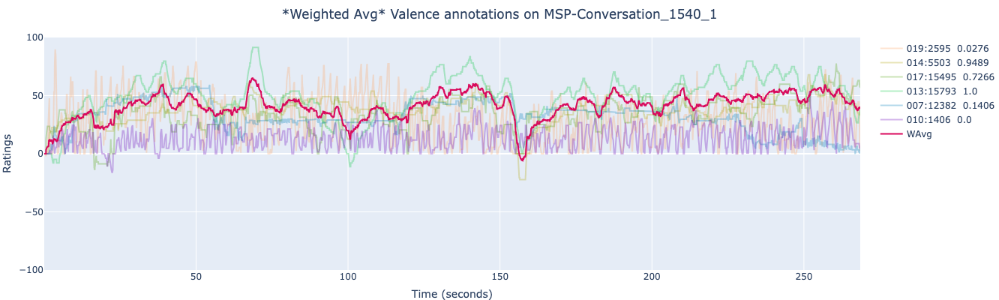

In [14]:
# df.iloc[0][0: -1].mean(), np.average(df.iloc[0][0: -1], weights=reps_scaled[:, 0],)

# df.iloc[:, 0:-1]

df_w = df.copy()
df_w['weighted_avg'] = np.average(df.iloc[:, 0:-1], weights=reps_scaled[:, 0], axis=1)

df_w = df_w.reset_index()
df_w = df_w.rename(columns={'weighted_avg': 'Annotation'})
df_w['Annotator'] = 'WAvg'
df_w = df_w[['Time', 'Annotator', 'Annotation']]

# clean variable....
dfannotation_vale_filtered, df_vale_filtered = filter_dfannotation(EMO_Valence, dfannotation_vale, PC_Num, Part_Num)

dfannotation_vale_filtered = (*dfannotation_vale_filtered, df_w)


iplot_for_one_conversation_part(EMO_Valence, dfannotation_vale_filtered, PC_Num, Part_Num, zoom=None, with_weghts=out) # zoom = [150, 200]

In [15]:
df_w.iloc[1000:1060, :]

,Time,Annotator,Annotation
1000,5.1510,WAvg,19.506694
1001,5.1515,WAvg,19.506694
1002,5.1533,WAvg,19.506694
1003,5.1682,WAvg,19.510211
1004,5.1697,WAvg,19.510211
1005,5.1716,WAvg,19.510211
1006,5.1848,WAvg,19.510211
1007,5.1849,WAvg,19.510211
1008,5.1880,WAvg,19.510211
1009,5.1933,WAvg,19.510211


## Experimental ------

In [16]:
# Setting up D3 URL
d3_lib_url = "https://d3js.org/d3.v3.min.js"

# JS function definition (Python multiline string)
draw_circle_lib = """
function draw_circle(div_id, data){
  d3.select(div_id)
    .append("div")
    .style("width", "50px")
    .style("height", "50px")
    .style("background-color", data.color)
    .style("border-radius", "50px")
}
"""

# Code execution using notebookjs
from notebookjs import execute_js
execute_js([d3_lib_url, draw_circle_lib,], "draw_circle", {"color": "#4682B4"})

In [17]:
from pydub import AudioSegment
import base64

def read_wav_segment_to_base64(file_path, start_time_ms, end_time_ms):
    # Load the WAV file
    audio = AudioSegment.from_file(file_path, format="wav")

    # Extract the specified segment
    segment = audio[start_time_ms:end_time_ms]

    # Convert the segment to base64
    segment_bytes = segment.export(format="wav").read()
    base64_encoded = base64.b64encode(segment_bytes).decode("utf-8")

    return base64_encoded
    

In [18]:
# Setting up plotly.js URL
plotly_lib_url = "https://cdn.plot.ly/plotly-2.25.2.min.js"
wavesurfer_lib_url = "https://cdnjs.cloudflare.com/ajax/libs/wavesurfer.js/2.0.4/wavesurfer.min.js"

audio_viz_js = """
function audio_viz(div_id, data){    
  var trace1 = {
    x: data.Time,
    y: data.Annotation0,
    type: 'scatter',
    name: 'Annot0',
  };

  var trace2 = {
    x: data.Time,
    y: data.Annotation1,
    type: 'scatter',
    name: 'Annot1',
  };

  var trace3 = {
    x: data.Time,
    y: data.Annotation6,
    type: 'scatter',
    name: 'WAvg',
  };

  var traces = [trace3];

  var layout = {
    shapes: [{
      type: 'line',
      x0: 100,
      y0: 0,
      x1: 100,
      yref: 'paper',
      y1: 1,
      line: {
        color: 'grey',
        width: 1.5,
        dash: 'dot'
      }
    }],
    title: `${data.emot} annotations on MSP-Conversation_${data.PC_Num}_${data.Part_Num}`,
    showlegend: true,
  };

  nid = document.querySelector(div_id);
  Plotly.newPlot(nid, traces, layout);

  const container = document.createElement("div");
  container.style.width = "1120px";
  container.style.marginLeft = "80px";
  container.id = "waveform";
  nid.appendChild(container);

  var wavesurfer = WaveSurfer.create({
    container: '#waveform',
    waveColor: "#9195f2",
    progressColor: "#c7c7c7",
    cursorColor: "#ea8b3e",
    cursorWidth: 2,
    barWidth: 3,
    barRadius: 30,
  });
  

  function refresh(position) {
    nid.layout.shapes[0].x0 = position;
    nid.layout.shapes[0].x1 = position;
    Plotly.redraw(nid);
  }

  const button = document.createElement("input");
  button.type = "button";
  button.value = "> play";
  button.style.paddingLeft = "80px";
  button.style.marginLeft = "80px";
  nid.appendChild(button)

  const indicator = document.createElement("div");
  indicator.class = "waveform-time-indicator";
  const time = document.createElement("span");
  time.innerHTML = "00:00:00";
  time.style.paddingLeft = "80px";
  time.class = "time";
  indicator.appendChild(time);
  nid.appendChild(indicator);  

  function base64ToArrayBuffer(base64) {
    var binaryString = atob(base64);
    var bytes = new Uint8Array(binaryString.length);
    for (var i = 0; i < binaryString.length; i++) {
        bytes[i] = binaryString.charCodeAt(i);
    }
    return bytes.buffer;
  }

  const arrBuffAudio = base64ToArrayBuffer(data.audio);
  wavesurfer.loadArrayBuffer(arrBuffAudio);

  function playPause() {
    wavesurfer.playPause();
    if (wavesurfer.isPlaying()) {
        button.value = "!! pause";
    } else {
        button.value = "> play";
    }
  }

  button.addEventListener("click", playPause);

  function secondsToTimestamp(seconds) {
    seconds = Math.floor(seconds);
    var h = Math.floor(seconds / 3600);
    var m = Math.floor((seconds - (h * 3600)) / 60);
    var s = seconds - (h * 3600) - (m * 60);

    h = h < 10 ? '0' + h : h;
    m = m < 10 ? '0' + m : m;
    s = s < 10 ? '0' + s : s;
    
    return h + ':' + m + ':' + s;
  }

  function updateTimer() {
    var formattedTime = secondsToTimestamp(wavesurfer.getCurrentTime());
    time.innerHTML = formattedTime;
    const currentpos = wavesurfer.getCurrentTime();
    refresh(currentpos);
  }

  wavesurfer.on('ready', updateTimer)
  wavesurfer.on('audioprocess', updateTimer)
  wavesurfer.on('seek', updateTimer)
    
}
"""

# Code execution using notebookjs
from notebookjs import execute_js
import json
import base64

audio = f"/Users/beltre.wilton/Downloads/SER-Datasets/MSP-Conversation-1.1/Audio/MSP-Conversation_{str(PC_Num).zfill(4)}.wav"
# Solo impl para la primera parte del audio, por ahora.
start_time = 0.0 * 1000
end_time = int(dfannotation_vale_filtered[0].Time.iloc[-1]) * 1000

# Read the WAV segment and convert to base64
encode_string = read_wav_segment_to_base64(audio, start_time, end_time)


execute_js([plotly_lib_url, wavesurfer_lib_url, audio_viz_js], "audio_viz", {
    "Annotation6": dfannotation_vale_filtered[6].Annotation.fillna(0).to_list(),
    "Time": dfannotation_vale_filtered[6].Time.to_list(),
    "audio": encode_string,
    "emot": EMO_Valence,
    "PC_Num": str(PC_Num).zfill(4),
    "Part_Num": Part_Num,
})

In [19]:
dfannotation_vale_filtered[6].fillna(0)

,Time,Annotator,Annotation
0,0.040000,WAvg,-0.002555
1,0.056944,WAvg,-0.002555
2,0.060974,WAvg,-0.002555
3,0.072634,WAvg,-0.002555
4,0.073124,WAvg,-0.002555
...,...,...,...
51959,268.512200,WAvg,39.417934
51960,268.515100,WAvg,39.417934
51961,268.528700,WAvg,39.417934
51962,268.529500,WAvg,39.417934
